In [144]:
# imports 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pingouin as pg
from datetime import datetime as dt
#from haversine import haversine
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
#from keplergl import KeplerGl
#import swifter
from tqdm.auto import tqdm
#import geopandas as gpd
# see all columns
pd.set_option('display.max_columns', None)
# set seaborn style
sns.set_style('whitegrid')
# set context to notebook
sns.set_context('notebook')

# Set the default template
pio.templates.default = "plotly_white"

In [38]:
trips = pd.read_csv('../data/processed/dr_short_oneway_trips.csv')

In [39]:
trips.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99265 entries, 0 to 99264
Data columns (total 36 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   StartTime                99265 non-null  object 
 1   EndTime                  99265 non-null  object 
 2   UserId                   99265 non-null  int64  
 3   latitudeStart            99265 non-null  float64
 4   longitudeStart           99265 non-null  float64
 5   nameStart                99265 non-null  object 
 6   latitudeEnd              99265 non-null  float64
 7   longitudeEnd             99265 non-null  float64
 8   nameEnd                  99265 non-null  object 
 9   StartHubClusterId        99265 non-null  int64  
 10  EndHubClusterId          99265 non-null  int64  
 11  StartClusterName         99265 non-null  object 
 12  EndClusterName           99265 non-null  object 
 13  StartClusterLatitude     99265 non-null  float64
 14  StartClusterLongitude 

In [40]:
# count the nr of unique UserId's
trips['UserId'].nunique()

25109

# Accessibility 

This section is dedicated to the analysis of the accessibility of the bike sharing system. We'll answer questions like:
 - How would the same trip look like if we were to use public transport?
 - How many people can access the bike sharing system within a given time?


# Accessibility Research Questions: Bike Trips vs. Public Transport

1. **Proximity and Mode Choice**: How does the closeness to bike-sharing stations versus public transport stops influence individuals' transportation choices?
2. **Total Trip Time Comparison**: What are the differences in total trip time, including walking and waiting times, when using bike-sharing versus public transport for typical urban journeys?
3. **Transfers and Time Penalties**: How do the number of transfers and related time costs compare between bike-sharing and public transport routes?
4. **Door-to-Door Travel Time**: How does door-to-door travel time vary between bike-sharing and public transport across different trip distances?
5. **Socio-Economic Accessibility**: How does accessibility to bike-sharing and public transport vary among different socio-economic groups and districts?
6. **Last-Mile Connectivity**: What impact does bike-sharing have on public transport use for completing the final segment of a journey?
7. **Influence of Weather Conditions**: How do weather conditions impact the choice between bike-sharing and public transport?
8. **Health Implications**: What are the health benefits and risks of choosing bike-sharing over public transport for regular commutes?
9. **Infrastructure's Role in Modal Choice**: How does the presence and quality of infrastructure, such as bike lanes and public transport frequency, influence the choice of transport mode?
10. **Integration for Efficiency**: Can the integration of bike-sharing data with public transport systems enhance overall travel efficiency and accessibility for city dwellers?


The research questions you've outlined for analyzing the accessibility of bike-sharing systems compared to public transport in Copenhagen are comprehensive and cover a wide range of factors influencing transportation choices. To ensure a thorough data science, machine learning, or deep learning analysis, it's crucial to align these questions closely with the available data and consider additional data that might enhance the analysis. Below, I'll evaluate and refine your research questions and suggest how to utilize the given dataset effectively, including potential improvements and the introduction of graph neural networks (GNNs) into your analysis.

### Evaluation and Refinement of Research Questions

1. **Proximity and Mode Choice**
   - **Existing Data**: 'PickupStationProximity', 'DropoffStationProximity'
   - **Improvement**: Investigate how the proximity to bike-sharing stations versus public transport stops quantitatively affects the likelihood of choosing one mode over the other. Consider collecting data on public transport stop locations for a more accurate comparison.
   
2. **Total Trip Time Comparison**
   - **Existing Data**: 'TripDurationMin', 'TotalDurationMin' (assuming this includes waiting and walking times for public transport)
   - **Improvement**: Ensure the comparison accounts for all components of travel time, including initial access, in-vehicle time, transfers, and final egress. Additional data on average waiting times for public transport could enhance this analysis.
   
3. **Transfers and Time Penalties**
   - **Existing Data**: 'Changes' (assumed to refer to public transport transfers)
   - **Improvement**: Analyze the impact of transfers on total trip time and user preference. Data on specific transfer penalties and waiting times would be beneficial.
   
4. **Door-to-Door Travel Time**
   - **Existing Data**: 'TotalDurationMin', 'TripDurationMin'
   - **Improvement**: This analysis can be performed with the current dataset. Consider categorizing trips by distance to examine trends across short, medium, and long distances.
   
5. **Socio-Economic Accessibility**
   - **Missing Data**: Socio-economic data by district or user
   - **Improvement**: Merge dataset with demographic information to explore disparities in accessibility. Variables such as income, age, and employment status could be relevant.
   
6. **Last-Mile Connectivity**
   - **Existing Data**: 'PickupStationProximity', 'DropoffStationProximity'
   - **Improvement**: Focus on the role of bike-sharing in enhancing access to public transport hubs. Data on public transport hub locations and their connectivity to final destinations would be useful.

    You can examine if shorter distances to public transport stops from bike-sharing stations correlate with increased bike-sharing usage, particularly for completing journeys that start or end at public transport hubs
   
7. **Influence of Weather Conditions**
   - **Missing Data**: Weather conditions on the day of the trip
   - **Improvement**: Incorporate weather data to assess its impact on mode choice. This could involve merging the dataset with historical weather information.
   
8. **Health Implications**
   - **Missing Data**: Health benefits or risks associated with modes of transport
   - **Improvement**: While direct health data may not be available, proxy measures such as trip frequency and duration could be used to infer potential health benefits. Additional health data would be needed for a more detailed analysis.
   
9. **Infrastructure's Role in Modal Choice**
   - **Missing Data**: Quality and presence of bike lanes, frequency of public transport
   - **Improvement**: Augment the dataset with information on cycling infrastructure and public transport service levels to analyze their impact on mode choice.
   
10. **Integration for Efficiency**
    - **Existing Data**: Comprehensive coverage with the existing dataset
    - **Improvement**: Examine how integrating bike-sharing and public transport data (schedules, real-time availability) could improve travel efficiency. Consider the feasibility of accessing and incorporating such data.

### Utilizing Graph Neural Networks (GNNs)

Graph Neural Networks could offer significant insights, particularly in understanding the network dynamics of multimodal transportation systems. Here's how GNNs could be applied:

- **Modeling the Transportation Network**: Represent Copenhagen's entire transportation network as a graph, where nodes represent both bike-sharing stations and public transport stops, and edges represent routes or possible transitions between modes.
- **Feature Engineering**: Use the existing dataset to create node and edge features, such as 'TripDurationMin', 'TotalDurationMin', 'Changes', and proximity measures. Socio-economic data and weather conditions, if available, can enhance node attributes.
- **Predictive Modeling**: GNNs can predict mode choice, trip time, and user preferences based on the network's structure and features. They could also simulate the impact of changes in the network, such as adding new bike stations or changing public transport schedules.

### Missing Columns for Further Analysis

- **Public Transport Stop Locations**: For a detailed comparison of accessibility.
- **Demographic Information**: To analyze socio-economic accessibility.
- **Weather Data**: To understand its impact on mode choice.
- **Transportation Infrastructure Data**: Details on bike lanes and public transport frequency.

### Conclusion

Your research questions are well-founded and address key aspects of

### Future implementation

Ml model to predict the demand forcasting of bike sharing system and cars.  
predict it per cluster. Predict the demand daily instead of hourly. We cannot use temporal features.
Create model given the socio economic status, day, night, weekday, season and weather. Build the model and apply for other areas where the bike sharing system is not present. 

In [41]:
trips.columns

Index(['StartTime', 'EndTime', 'UserId', 'latitudeStart', 'longitudeStart',
       'nameStart', 'latitudeEnd', 'longitudeEnd', 'nameEnd',
       'StartHubClusterId', 'EndHubClusterId', 'StartClusterName',
       'EndClusterName', 'StartClusterLatitude', 'StartClusterLongitude',
       'EndClusterLatitude', 'EndClusterLongitude', 'HaversineDistance',
       'Month', 'StartHour', 'Weekday', 'TripDurationMin', 'TripDurationHr',
       'SpeedKmHr', 'RoundTrip', 'Route', 'YearMonth', 'DurationGroup',
       'StartTimeUpdated', 'TotalDurationMin', 'TripDistanceKm',
       'TotalWalkingTimeMin', 'TotalTransitTimeMin', 'Changes',
       'PickupStationProximity', 'DropoffStationProximity'],
      dtype='object')

In [42]:
# create 2 new cols SpeedKmHrHav - for haversine HaversineDistance and SpeedKmHrP for public transport from TripDistanceKm 
trips['SpeedKmHrHav'] = trips['HaversineDistance'] / trips['TripDurationHr']
trips['SpeedKmHrP'] = trips['TripDistanceKm'] / trips['TripDurationHr']


In [43]:
trips['SpeedKmHrHav'].describe()


count    99265.000000
mean         6.255271
std          3.414048
min          0.036503
25%          3.701692
50%          6.373799
75%          8.698919
max        149.321414
Name: SpeedKmHrHav, dtype: float64

In [44]:
# print the row where SpeedKmHrHav is max 
trips[trips['SpeedKmHrHav'] == trips['SpeedKmHrHav'].max()]

,StartTime,EndTime,UserId,latitudeStart,longitudeStart,nameStart,latitudeEnd,longitudeEnd,nameEnd,StartHubClusterId,EndHubClusterId,StartClusterName,EndClusterName,StartClusterLatitude,StartClusterLongitude,EndClusterLatitude,EndClusterLongitude,HaversineDistance,Month,StartHour,Weekday,TripDurationMin,TripDurationHr,SpeedKmHr,RoundTrip,Route,YearMonth,DurationGroup,StartTimeUpdated,TotalDurationMin,TripDistanceKm,TotalWalkingTimeMin,TotalTransitTimeMin,Changes,PickupStationProximity,DropoffStationProximity,SpeedKmHrHav,SpeedKmHrP
55644,2018-10-20 11:20:36.528255,2018-10-20 11:25:24.382638,157130,55.683192,12.57633,Åbenrå,55.786206,12.52252,Dtu Building 101,35,10,Kultorvet,Dtu Building 101,55.682898,12.575033,55.786213,12.522534,11.939673,October,11,Saturday,4.797573,0.07996,38.769602,False,Kultorvet -> Dtu Building 101,2018-10,0-1 hour,2023-11-18 11:20:36.528255,38.033333,13.90305,14.033333,24.0,0.0,293.43,705.73,149.321414,173.876039


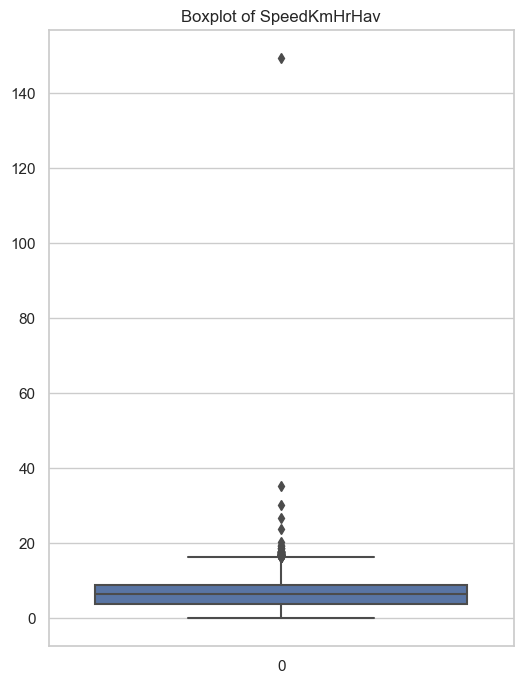

In [45]:
# boxplot for SpeedKmHrHav
plt.figure(figsize=(6,8))
sns.boxplot(trips['SpeedKmHrHav'])
plt.title('Boxplot of SpeedKmHrHav')
plt.show()

In [46]:
# Calculate the IQR for SpeedKmHrHav
Q1 = trips['SpeedKmHrHav'].quantile(0.25)
Q3 = trips['SpeedKmHrHav'].quantile(0.75)
IQR = Q3 - Q1

# Calculate the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

(lower_bound, upper_bound)

(-3.7941492715113463, 16.19475964676333)

In [47]:
# clean the trips dataframe from outliers in SpeedKmHrHav and keep the speed between 2.5 and 16.5 km/hr
trips = trips[(trips['SpeedKmHrHav'] >= 2.5) & (trips['SpeedKmHrHav'] <= 16.6)]

In [49]:
trips.HaversineDistance.describe()

count    82253.000000
mean         2.588792
std          1.320516
min          0.086317
25%          1.634160
50%          2.364606
75%          3.306583
max         14.453685
Name: HaversineDistance, dtype: float64

### Proximity and Mode Choice
How does the closeness to bike-sharing stations versus public transport stops influence individuals' transportation choices?


Given this setup, we can plot the distribution of these proximity measures to understand their influence on the mode choice. A compelling visualization for this purpose would be a dual histogram or KDE plot that shows the distribution of distances to the nearest public transport station for both pickup and dropoff points, highlighting the range of distances where bike-sharing might be more preferred.

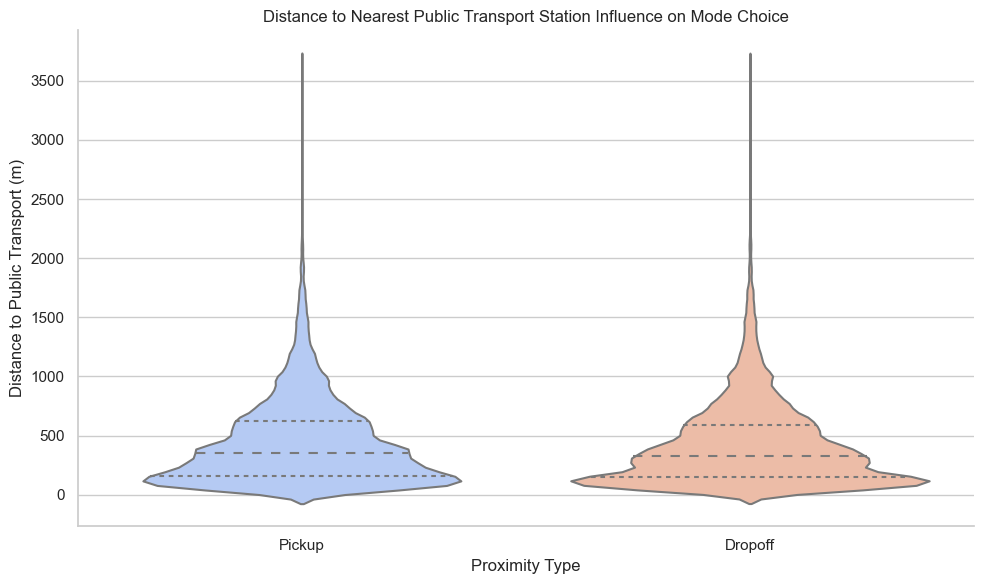

In [50]:
# import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Sample data creation (replace this with your actual DataFrame)
# data = {
#     'PickupStationProximity': np.random.uniform(0.1, 2, 100),
#     'DropoffStationProximity': np.random.uniform(0.1, 2, 100),
# }
# df = pd.DataFrame(data)

# Assuming df is your DataFrame with the relevant columns
# Let's melt the DataFrame to have a long-form DataFrame suitable for our plotting
df_melted = pd.melt(trips, value_vars=['PickupStationProximity', 'DropoffStationProximity'], var_name='ProximityType', value_name='DistanceToPublicTransport')

# Plotting
plt.figure(figsize=(10, 6))
sns.set(style="whitegrid", palette="muted")
ax = sns.violinplot(x='ProximityType', y='DistanceToPublicTransport', data=df_melted, inner="quartile", palette="coolwarm", native_scale=True)
sns.despine()

plt.title('Distance to Nearest Public Transport Station Influence on Mode Choice')
plt.ylabel('Distance to Public Transport (m)')
plt.xlabel('Proximity Type')
plt.xticks([0, 1], ['Pickup', 'Dropoff'])
plt.tight_layout()

plt.show()


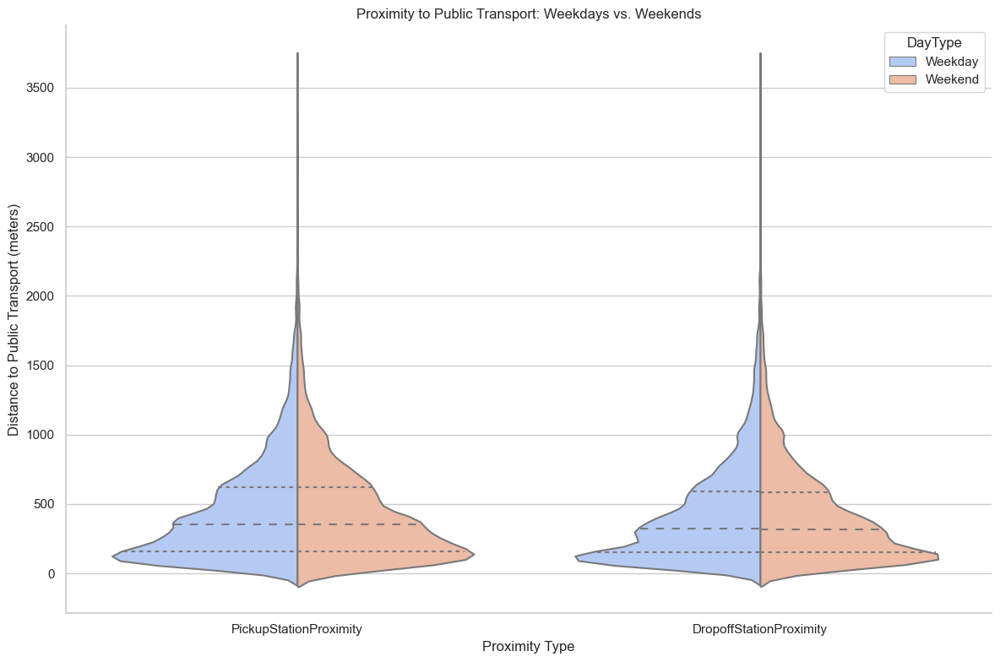

In [51]:
# To incorporate weekdays vs weekends, we first need to classify the 'Weekday' column appropriately
# Assuming 'Weekday' contains numeric values representing days of the week (e.g., 0 for Monday, 6 for Sunday)
# We will create a new column 'DayType' to categorize days into 'Weekday' and 'Weekend'

# To incorporate weekdays vs weekends, we first need to classify the 'Weekday' column appropriately
# Assuming 'Weekday' contains words representing days of the week (e.g., 'Monday', 'Tuesday', etc.)
# We will create a new column 'DayType' to categorize days into 'Weekday' and 'Weekend'

# Mapping of weekdays to their respective categories
weekday_mapping = {
    'Monday': 'Weekday',
    'Tuesday': 'Weekday',
    'Wednesday': 'Weekday',
    'Thursday': 'Weekday',
    'Friday': 'Weekday',
    'Saturday': 'Weekend',
    'Sunday': 'Weekend'
}

# Categorize 'Weekday' into 'Weekday' and 'Weekend'
trips['DayType'] = trips['Weekday'].map(weekday_mapping)

# Correctly merging the 'DayType' information with the melted DataFrame
# The issue likely arose from how 'DayType' was joined with 'df_melted'
# Ensure 'DayType' is correctly included for each row in 'df_melted'

# Melt the DataFrame again to ensure a clean start
df_melted_correct = pd.melt(trips, id_vars=['DayType'], value_vars=['PickupStationProximity', 'DropoffStationProximity'], 
                            var_name='ProximityType', value_name='DistanceToPublicTransport')

# Now, let's try plotting again
plt.figure(figsize=(12, 8))
sns.violinplot(x='ProximityType', y='DistanceToPublicTransport', hue='DayType',
               data=df_melted_correct, inner="quart", palette="coolwarm", split=True)
plt.title('Proximity to Public Transport: Weekdays vs. Weekends')
plt.xlabel('Proximity Type')
plt.ylabel('Distance to Public Transport (meters)')
sns.despine()

plt.tight_layout()
plt.show()



In [52]:
df_melted.head()

,ProximityType,DistanceToPublicTransport
0,PickupStationProximity,324.78
1,PickupStationProximity,80.07
2,PickupStationProximity,100.86
3,PickupStationProximity,190.22
4,PickupStationProximity,267.99


In [150]:
# Using df_melted_correct as the DataFrame
fig = px.violin(df_melted_correct, x='ProximityType', y='DistanceToPublicTransport', color='DayType',
                box=True, points="outliers",
                title='Distance to Nearest Public Transport Station: Weekdays vs. Weekends',
                labels={'ProximityType': 'Proximity Type', 'DistanceToPublicTransport': 'Distance to Public Transport (m)'},
                category_orders={'ProximityType': ['PickupStationProximity', 'DropoffStationProximity'], 'DayType': ['Weekday', 'Weekend']},
                violinmode='overlay')  # Note: Corrected 'violinmode' from 'overalay' to 'overlay'

fig.update_traces(meanline_visible=True)
fig.update_layout(showlegend=True, width=700, height=800, legend=dict(x=0.5, y=1.05))

fig.show()


The violin plot above illustrates the distribution of distances to the nearest public transport station for both pickup and dropoff locations. The distribution provides insights into the typical proximity of bike-sharing trips to public transport stations, which can help infer the role of station accessibility in transportation mode selection.

Key observations from the plot might include:
- The spread of distances, indicating the range within which most bike-sharing stations are located from public transport stops.
- The median distance, highlighted by the inner quartile marker, showing the most common proximity to public transport stations.
- Any differences in the distribution between pickup and dropoff locations, which might suggest varying accessibility or user preferences at the start vs. the end of trips.

This visualization can serve as a basis for further analysis on how proximity to public transport influences the choice of bike-sharing, potentially guiding infrastructure planning or improvements to the bike-sharing system to better complement public transport networks.

In [134]:
trips.columns

Index(['StartTime', 'EndTime', 'UserId', 'latitudeStart', 'longitudeStart',
       'nameStart', 'latitudeEnd', 'longitudeEnd', 'nameEnd',
       'StartHubClusterId', 'EndHubClusterId', 'StartClusterName',
       'EndClusterName', 'StartClusterLatitude', 'StartClusterLongitude',
       'EndClusterLatitude', 'EndClusterLongitude', 'HaversineDistance',
       'Month', 'StartHour', 'Weekday', 'TripDurationMin', 'TripDurationHr',
       'SpeedKmHr', 'RoundTrip', 'Route', 'YearMonth', 'DurationGroup',
       'StartTimeUpdated', 'TotalDurationMin', 'TripDistanceKm',
       'TotalWalkingTimeMin', 'TotalTransitTimeMin', 'Changes',
       'PickupStationProximity', 'DropoffStationProximity', 'SpeedKmHrHav',
       'SpeedKmHrP', 'DayType', 'UserCategory'],
      dtype='object')

C:\Users\mihai\AppData\Local\Temp\ipykernel_10184\2564900473.py:4: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



C:\Users\mihai\AppData\Local\Temp\ipykernel_10184\2564900473.py:5: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

C:\Users\mihai\AppData\Local\Temp\ipykernel_10184\2564900473.py:12: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

C:\Users\mihai\AppData\Local\Temp\ipykernel_10184\2564900473.py:13: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



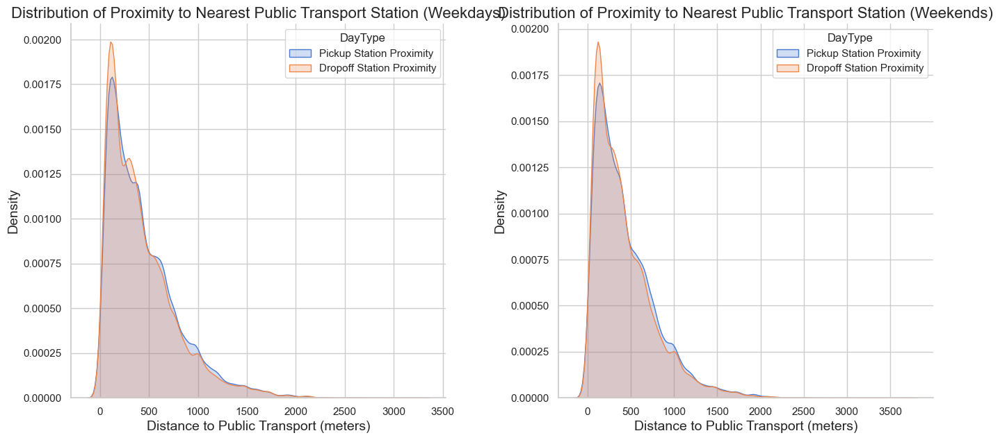

In [56]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 7))

# Plot for Weekdays
sns.kdeplot(data=trips[trips['DayType'] == 'Weekday'], x='PickupStationProximity', fill=True, palette='Set1', label="Pickup Station Proximity", ax=axes[0])
sns.kdeplot(data=trips[trips['DayType'] == 'Weekday'], x='DropoffStationProximity', fill=True, palette='Set2', label="Dropoff Station Proximity", ax=axes[0])
axes[0].set_title('Distribution of Proximity to Nearest Public Transport Station (Weekdays)', fontdict={'fontsize': 16})
axes[0].set_xlabel('Distance to Public Transport (meters)', fontdict={'fontsize': 14})
axes[0].set_ylabel('Density', fontdict={'fontsize': 14})
axes[0].legend(title='DayType')

# Plot for Weekends
sns.kdeplot(data=trips[trips['DayType'] == 'Weekend'], x='PickupStationProximity', fill=True, palette='Set1', label="Pickup Station Proximity", ax=axes[1])
sns.kdeplot(data=trips[trips['DayType'] == 'Weekend'], x='DropoffStationProximity', fill=True, palette='Set2', label="Dropoff Station Proximity", ax=axes[1])
axes[1].set_title('Distribution of Proximity to Nearest Public Transport Station (Weekends)', fontdict={'fontsize': 16})
axes[1].set_xlabel('Distance to Public Transport (meters)', fontdict={'fontsize': 14})
axes[1].set_ylabel('Density', fontdict={'fontsize': 14})
axes[1].legend(title='DayType')

# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.3)

sns.despine()
plt.show()


This type of visualization will allow us to see not just the range and commonality of distances but also how smooth the distribution is across different distances, potentially indicating the preference for bike-sharing based on how close or far users are from public transport stations.

The KDE plot above displays the density distributions for both `PickupStationProximity` and `DropoffStationProximity`, with the distances to the nearest public transport station measured in meters. This visualization provides a clear comparison of how close users are to public transport stations when they pick up and drop off bikes, highlighting potential preferences for bike-sharing usage based on proximity.

Key insights that can be drawn from this plot include:
- The peak of each curve indicates the most common distance to public transport stations for both pickup and dropoff points, suggesting a concentration of bike-sharing usage around these distances.
- The width and shape of the distributions show the range and variability of distances users are from public transport stations when they choose to use bike-sharing.
- Any significant differences between the pickup and dropoff distributions might indicate preferences for using bike-sharing at either the start or end of a trip, potentially influenced by factors like the purpose of the trip, availability of public transport, or personal convenience.

This analysis helps understand the role of public transport station proximity in influencing bike-sharing as a mode choice, providing valuable insights for urban planning, transportation policy, and the strategic placement of bike-sharing stations to complement public transport systems effectively.

### Violin Plot Analysis
The violin plot provides a detailed view of the distribution of distances to the nearest public transport station for both pickup and dropoff points. Here are some key observations and comments:

- **Distribution Shape**: The violin plot combines aspects of a box plot with a kernel density plot, showing the distribution's thickness at different points. This shape can indicate where the data is concentrated and where it tapers off, providing a visual representation of the density of proximity measures.
- **Median and Quartiles**: The inner markers show the median and quartiles, offering insights into the central tendency and spread of the data. These markers can help identify the typical distance to public transport stations for users when starting or ending their bike trips.
- **Symmetry and Outliers**: The symmetry of each violin plot can indicate the skewness of the distribution, while the width indicates the variability of distances. If there were any outliers or extreme values, they might be represented by the tails of the violins, although they're more abstract in this visualization.
- **Comparison Between Pickup and Dropoff**: The side-by-side placement allows for a direct comparison of pickup and dropoff station proximities. Any significant differences in the shapes, widths, or median positions could suggest varying preferences or accessibility issues at the start versus the end of trips.

### KDE Plot Analysis
The KDE plot overlays the density estimates for pickup and dropoff station proximities, providing a smooth representation of the data distribution. Here are some insights from the KDE plot:

- **Density Peaks**: The peaks of the KDE plot represent the most common distances to public transport stations for pickups and dropoffs. A higher peak suggests a higher concentration of data points around that distance, indicating a preference or higher likelihood of bike-sharing usage at those proximities.
- **Spread and Overlap**: The spread of the KDE curves shows the range of distances covered by bike-sharing users, while the overlap between the pickup and dropoff distributions can indicate similarities in proximity preferences for both trip endpoints.
- **Comparison of Preferences**: By comparing the two curves, we can infer if there's a distinct preference for bike-sharing usage closer to or further from public transport stations, depending on whether the trip is starting or ending. The relative height and width of the curves can also suggest which part of the trip (start or end) has a more flexible or constrained choice in proximity to public transport.

### Overall Comments
Both plots provide valuable insights into how the proximity to public transport stations influences bike-sharing usage. The violin plot offers a detailed look at the distribution's structure, including its central tendency and variability, while the KDE plot provides a smooth and continuous view of the density of proximity measures, allowing for easy comparison between pickup and dropoff distributions. Together, these visualizations help elucidate the relationship between bike-sharing system usage and public transport accessibility, supporting data-driven decisions for urban planning and transportation system integration.

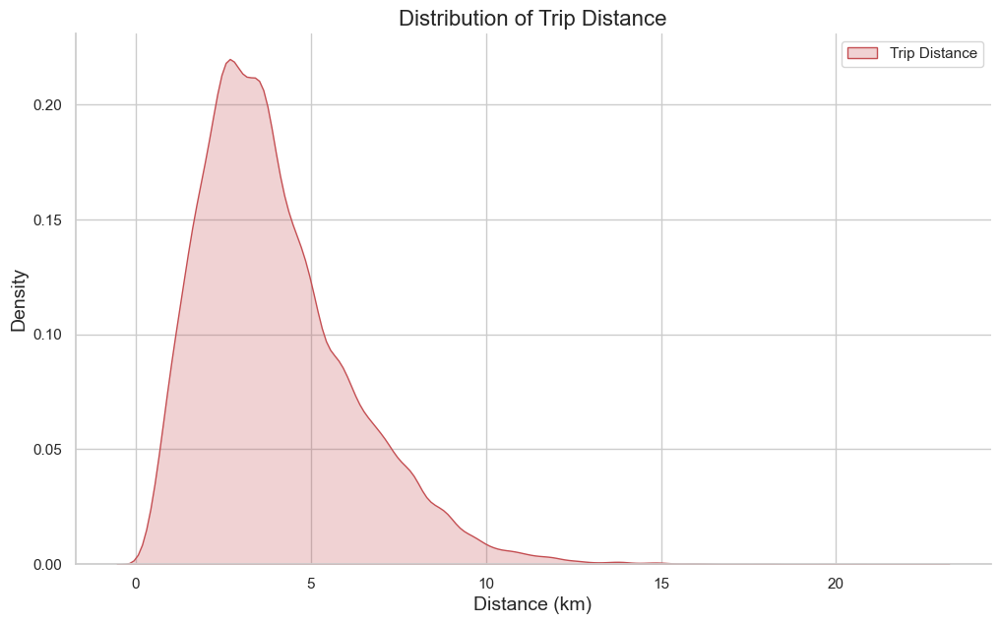

In [151]:
# plot the distribution of TripDistanceKm from public transport stations
plt.figure(figsize=(12, 7))
sns.kdeplot(trips['TripDistanceKm'], fill=True, color="r", label="Trip Distance")
plt.title('Distribution of Trip Distance', fontdict={'fontsize': 16})
plt.xlabel('Distance (km)', fontdict={'fontsize': 14})
plt.ylabel('Density', fontdict={'fontsize': 14})
plt.legend()

sns.despine()
plt.show()


2. **Total Trip Time Comparison**
   - **Existing Data**: 'TripDurationMin', 'TotalDurationMin' (assuming this includes waiting and walking times for public transport)
   - **Improvement**: Ensure the comparison accounts for all components of travel time, including initial access, in-vehicle time, transfers, and final egress. Additional data on average waiting times for public transport could enhance this analysis.
   

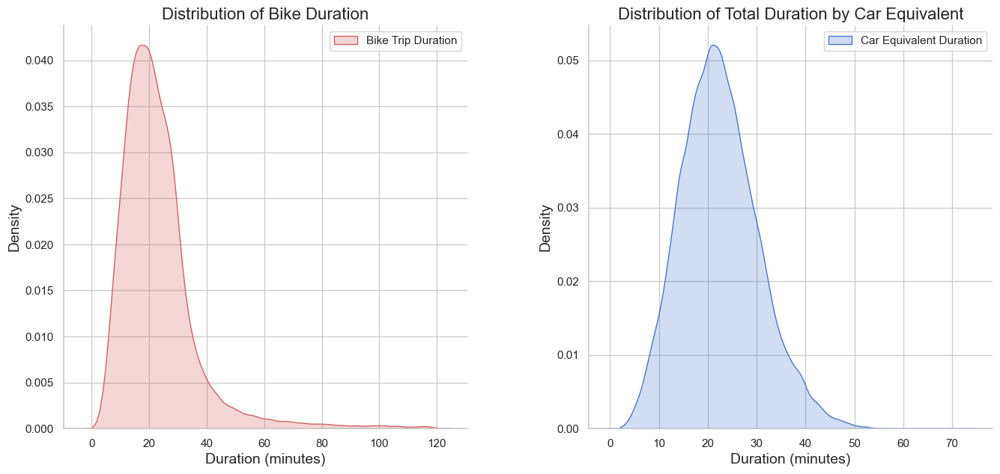

In [58]:
# plot the distribution of TripDurationMin and TotalDurationMin (which is the Car equivalent)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 7))

# Plot for TripDurationMin
sns.kdeplot(trips['TripDurationMin'], fill=True, color="r", label="Bike Trip Duration", ax=axes[0])
axes[0].set_title('Distribution of Bike Duration', fontdict={'fontsize': 16})
axes[0].set_xlabel('Duration (minutes)', fontdict={'fontsize': 14})
axes[0].set_ylabel('Density', fontdict={'fontsize': 14})
axes[0].legend()

# Plot for TotalDurationMin
sns.kdeplot(trips['TotalDurationMin'], fill=True, color="b", label="Car Equivalent Duration", ax=axes[1])
axes[1].set_title('Distribution of Total Duration by Car Equivalent', fontdict={'fontsize': 16})
axes[1].set_xlabel('Duration (minutes)', fontdict={'fontsize': 14})
axes[1].set_ylabel('Density', fontdict={'fontsize': 14})
axes[1].legend()

# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.3)

sns.despine()
plt.show()

In [59]:
# Assuming 'trips' is your DataFrame and it includes 'TripDurationMin' and 'TotalDurationMin' columns
# First, reshape the DataFrame to long format
long_df = pd.melt(trips, value_vars=['TripDurationMin', 'TotalDurationMin'], 
                  var_name='DurationType', value_name='Duration')

# Now, plot with the adjusted DataFrame
fig = px.violin(long_df, y='Duration', x='DurationType', box=True, points='outliers',
                color='DurationType',  # This will differentiate the colors based on the duration type
                color_discrete_map={'TripDurationMin': 'red', 'TotalDurationMin': 'blue'})  # Custom color for each type

fig.update_layout(title='Distribution of Bike and Car Equivalent Durations',
                  xaxis_title='Duration Type',
                  yaxis_title='Duration (minutes)',
                  xaxis=dict(tickmode='array', tickvals=[0, 1], ticktext=['Bike Trip Duration', 'Car Equivalent Duration']),
                legend_title='Duration Type', width=800, height=600)

fig.show()


In [60]:
# Descbriptive statistics for TripDurationMin and TotalDurationMin
trips[['TripDurationMin', 'TotalDurationMin']].describe()

,TripDurationMin,TotalDurationMin
count,82253.000000,82253.000000
mean,23.173513,22.396934
std,13.995519,7.953673
min,1.042302,1.850000
25%,14.647382,16.783333
50%,20.625294,21.850000
75%,27.661754,27.366667
max,119.918954,72.016667


In [61]:
trips.DurationGroup.value_counts(normalize=True)

DurationGroup
0-1 hour     0.972876
1-4 hours    0.027124
Name: proportion, dtype: float64

In [62]:
# compare TripDurationMin and TotalDurationMin 
duration_desc = trips[['TripDurationMin','TotalDurationMin']].describe()


In [63]:
duration_desc

,TripDurationMin,TotalDurationMin
count,82253.000000,82253.000000
mean,23.173513,22.396934
std,13.995519,7.953673
min,1.042302,1.850000
25%,14.647382,16.783333
50%,20.625294,21.850000
75%,27.661754,27.366667
max,119.918954,72.016667


In [64]:
# get the percentage difference between TripDurationMin and TotalDurationMin from duration_desc
duration_desc['Difference (%)'] = (duration_desc['TripDurationMin'] - duration_desc['TotalDurationMin'])/duration_desc['TripDurationMin']


In [65]:
# cut the 1st column from duration_desc
duration_desc

,TripDurationMin,TotalDurationMin,Difference (%)
count,82253.000000,82253.000000,0.000000
mean,23.173513,22.396934,0.033512
std,13.995519,7.953673,0.431699
min,1.042302,1.850000,-0.774918
25%,14.647382,16.783333,-0.145825
50%,20.625294,21.850000,-0.059379
75%,27.661754,27.366667,0.010668
max,119.918954,72.016667,0.399456


C:\Users\mihai\AppData\Local\Temp\ipykernel_10184\432342822.py:5: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



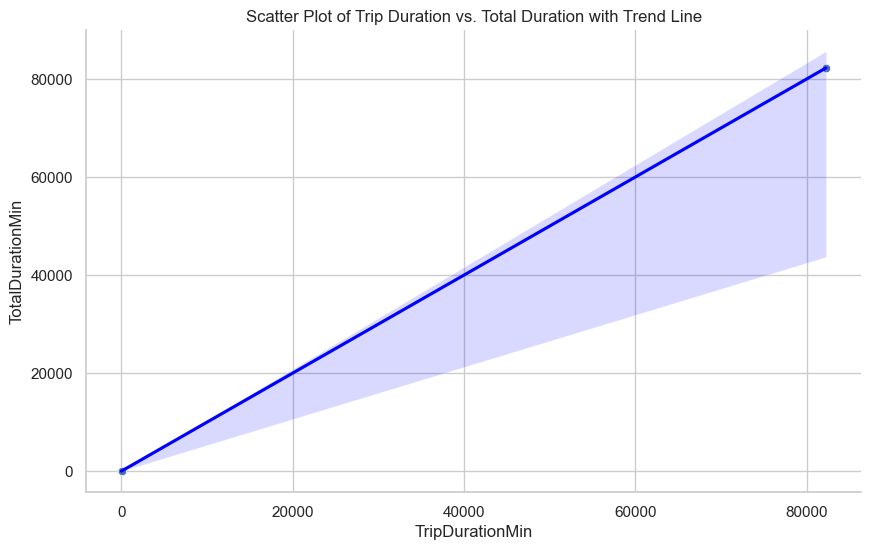

In [66]:
sns.set_theme(style="whitegrid")  # Sets the theme for Seaborn plots

# Create the scatter plot with a trend line
plt.figure(figsize=(10, 6))
scatter = sns.scatterplot(x='TripDurationMin', y='TotalDurationMin', data=duration_desc, palette="coolwarm")
sns.regplot(x='TripDurationMin', y='TotalDurationMin', data=duration_desc, scatter=False, color="blue")
plt.title('Scatter Plot of Trip Duration vs. Total Duration with Trend Line')
sns.despine()  # Removes the top and right spines

plt.show()


3. **Transfers and Time Penalties**
   - **Existing Data**: 'Changes' (assumed to refer to public transport transfers)
   - **Improvement**: Analyze the impact of transfers on total trip time and user preference. Data on specific transfer penalties and waiting times would be beneficial.

In [67]:
# convert Changes to category
#trips['Changes'] = trips['Changes'].astype('category', ordered=True)    
# count nr of Changes 
trips['Changes'].value_counts(normalize=True)


Changes
0.0    0.875506
1.0    0.119473
2.0    0.005009
3.0    0.000012
Name: proportion, dtype: float64

C:\Users\mihai\AppData\Local\Temp\ipykernel_10184\1132497987.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



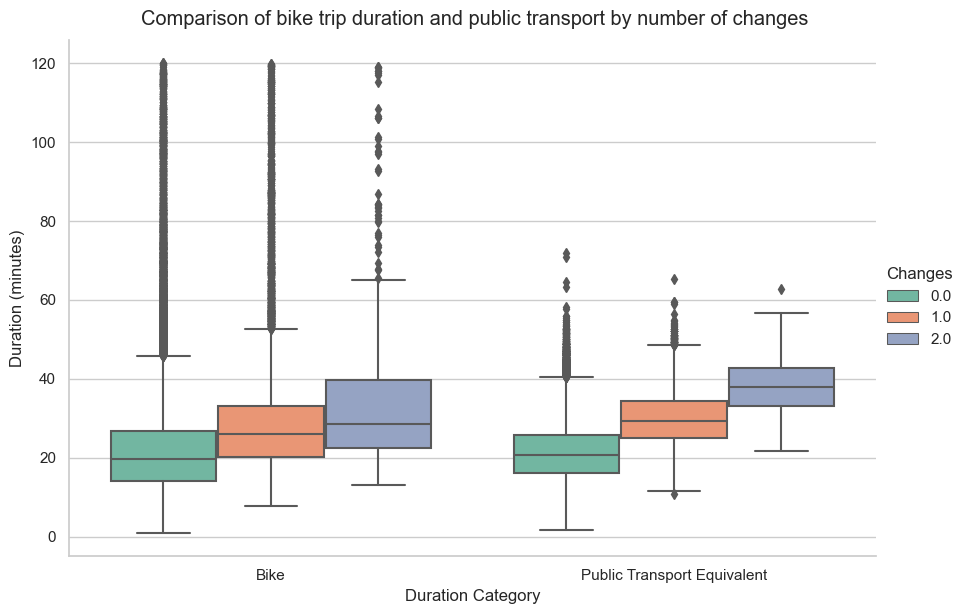

In [68]:
# Filter the dataset for changes up to 2
df_filtered = trips[trips['Changes'] <= 2]

# Convert 'Changes' to categorical type
df_filtered['Changes'] = df_filtered['Changes'].astype('category')

# Preparing the data: Since sns.catplot does not support direct comparison of two columns in the way px.box does,
# we need to melt the DataFrame
trips_melted = pd.melt(df_filtered, id_vars=['Changes'], value_vars=['TripDurationMin', 'TotalDurationMin'],
                    var_name='DurationType', value_name='Duration')

# Creating the catplot with boxplots
g = sns.catplot(x='DurationType', y='Duration', hue='Changes', data=trips_melted, kind='box',
                height=6, aspect=1.5, palette='Set2')

g.fig.suptitle('Comparison of bike trip duration and public transport by number of changes', y=1.02)
g.set_axis_labels('Duration Category', 'Duration (minutes)')
# set xticks
g.set_xticklabels(['Bike', 'Public Transport Equivalent'])
g.set_titles("{col_name}")

plt.show()


In [133]:
pairwise_results = pg.pairwise_tests(data=trips, dv='Changes', between=['TripDurationMin', 'TotalDurationMin'], padjust='bonf').round(4)
pairwise_results

MemoryError: 

  - analyze each area (zone), ex amager, center of cop, norrebro ...
  - the time it takes for both
  - see where people benefit more by taking the bikes
  - spacial analysis for each area and color code with differences

In [69]:
trips_melted.head()

,Changes,DurationType,Duration
0,0.0,TripDurationMin,30.957293
1,0.0,TripDurationMin,17.704322
2,0.0,TripDurationMin,23.922983
3,1.0,TripDurationMin,29.792578
4,0.0,TripDurationMin,36.300314


In [71]:
import pingouin as pg

# perform pairwise comparisons using pingouin.pairwise_tests on trips_melted for the 'DurationType' and 'Changes' columns
pairwise_results = pg.pairwise_tests(data=trips_melted, dv='Duration', between=['Changes','DurationType'], padjust='bonf').round(4)
pairwise_results

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\bayesian.py:152: RuntimeWarning:

divide by zero encountered in scalar divide



,Contrast,Changes,A,B,Paired,Parametric,T,dof,alternative,p-unc,p-corr,p-adjust,BF10,hedges
0,Changes,-,0.0,1.0,False,True,-86.4547,23347.9779,two-sided,0.0000,0.0000,bonf,inf,-0.7675
1,Changes,-,0.0,2.0,False,True,-27.0220,826.9842,two-sided,0.0000,0.0000,bonf,2.058e+156,-1.4443
2,Changes,-,1.0,2.0,False,True,-12.1427,867.4988,two-sided,0.0000,0.0000,bonf,2.344e+30,-0.5311
3,DurationType,-,TotalDurationMin,TripDurationMin,False,True,-13.8383,164502.0000,two-sided,0.0000,NaN,NaN,1.998e+39,-0.0682
4,Changes * DurationType,0.0,TotalDurationMin,TripDurationMin,False,True,-15.4618,144024.0000,two-sided,0.0000,0.0000,bonf,4.35e+49,-0.0815
5,Changes * DurationType,1.0,TotalDurationMin,TripDurationMin,False,True,-1.1974,19652.0000,two-sided,0.2312,0.6935,bonf,0.033,-0.0171
6,Changes * DurationType,2.0,TotalDurationMin,TripDurationMin,False,True,1.6787,822.0000,two-sided,0.0936,0.2808,bonf,0.31,0.1169


### Interpretation:

- **Changes**: The first three rows compare groups with different numbers of changes (0 vs 1, 0 vs 2, and 1 vs 2). The p-values (`p-unc`) are extremely low, indicating significant differences in durations across these groups. The Bonferroni-adjusted p-values (`p-corr`) confirm these findings remain significant even after adjustment for multiple comparisons. The effect sizes (`hedges`) suggest a small to moderate negative impact as the number of changes increases.
  
- **DurationType**: The comparison between `TotalDurationMin` and `TripDurationMin` without considering changes shows a highly significant difference (p < 0.0001), indicating that overall, trip durations and total durations are significantly different from each other.

- **Changes * DurationType**: This set of comparisons examines the differences between `TotalDurationMin` and `TripDurationMin` within each level of changes (0, 1, 2). For changes levels 0 and 1, there are highly significant differences between trip durations and total durations, suggesting that, generally, public transport durations are longer than bike trip durations for these levels of changes. For change level 2, the comparison is not statistically significant (p-unc = 0.2017, p-corr = 0.6051 after Bonferroni adjustment), indicating no significant difference between trip and total durations for trips with 2 changes.

The Bonferroni correction is a statistical adjustment method used to counteract the problem of multiple comparisons. When conducting multiple statistical tests simultaneously, the chance of incorrectly rejecting at least one true null hypothesis (Type I error) increases with the number of tests. The Bonferroni correction mitigates this issue by lowering the significance threshold for each individual test, thus controlling the overall Type I error rate across all tests.

The correction is straightforward: if you are performing $n$ comparisons and your significance level for each test is $\alpha$, the Bonferroni corrected significance level becomes $\frac{\alpha}{n}$. This method is conservative, ensuring that the familywise error rate (the probability of making one or more Type I errors in a family of tests) is kept at or below $\alpha$.

### Summary:

The two-sided pairwise comparisons reveal significant differences in durations between bike trips (`TripDurationMin`) and public transport (`TotalDurationMin`) for 0 and 1 changes, with very low p-values suggesting strong evidence of disparity. For 2 changes, no significant difference is detected, indicating similar durations for bike and public transport trips in this context.

### Conclusion:

Applying the Bonferroni correction for multiple comparisons, the analysis demonstrates that bike trip durations significantly differ from public transport durations when fewer changes are involved. However, for trips with 2 changes, durations converge, suggesting trip complexity influences the similarity in durations between these modes of transportation.

## 6. **Last-Mile Connectivity**
   - **Existing Data**: 'PickupStationProximity', 'DropoffStationProximity'
   - **Improvement**: Focus on the role of bike-sharing in enhancing access to public transport hubs. Data on public transport hub locations and their connectivity to final destinations would be useful.

    You can examine if shorter distances to public transport stops from bike-sharing stations correlate with increased bike-sharing usage, particularly for completing journeys that start or end at public transport hubs

Below is a Markdown text crafted for use in VS Code, incorporating LaTeX for mathematical notation where necessary. This description outlines the approach for analyzing last-mile connectivity in the context of bike-sharing and public transport integration.

---

# Last-Mile Connectivity Analysis

## Objective

The goal of this analysis is to investigate the role of bike-sharing in facilitating last-mile connectivity in urban environments. Specifically, we aim to understand how bike-sharing services complement public transport by serving as a first or last-mile solution for commuters. This involves analyzing bike pickups and dropoffs in proximity to public transport stations.

## Methodology

### Data Filtering

We separate the analysis into two main scenarios based on the proximity to public transport stations:

1. **Pickup Proximity**: Identifying trips where bikes are picked up within 500 meters of a public transport station. These represent potential first-mile connections.

    

2. **Dropoff Proximity**: Identifying trips where bikes are dropped off within 500 meters of a public transport station. These represent potential last-mile connections.

### Analysis Points

- **Frequency of Use**: Assess how frequently bike-sharing is used in conjunction with public transport, focusing on the start and end of the day.
  
- **Proximity Correlation**: Examine the relationship between the proximity to public transport stations and the usage of bike-sharing services.

- **Trip Characteristics**: Analyze the features of trips linked to public transport usage, including trip duration, distance, and timing.

## Expected Outcomes

Through this analysis, we aim to uncover insights into:

- The effectiveness of bike-sharing as a first and last-mile solution.
- Patterns of bike-sharing usage in relation to public transport hubs.
- Opportunities for enhancing urban mobility and public transport integration with bike-sharing services.

## Conclusion

Understanding last-mile connectivity's dynamics is crucial for improving urban transportation networks. This analysis seeks to provide valuable data-driven insights to support decision-making for urban planners and bike-sharing operators, ultimately enhancing the commuter experience in urban areas.

To perform a robust analysis of last-mile connectivity using bike-sharing data, and to validate that the trips are indeed serving as connections to public transport, we need to refine our approach and consider additional data or validation strategies. Here are some steps and considerations to enhance the analysis:

### 1. **Refine Last-Mile Trip Criteria**:
- **Exclude Dual Proximity**: Exclude trips that are close to public transport stations at both start and end points, as these might not represent typical last-mile connectivity but rather short loops around transport hubs or within residential areas.
- **Distance Thresholds**: Re-evaluate the distance criteria for defining last-mile trips. Consider adjusting the maximum acceptable `HaversineDistance` based on urban density and typical last-mile distances in the specific city.
- **Duration Thresholds**: Implement duration thresholds that more accurately reflect realistic biking times for last-mile distances, considering average biking speeds and urban traffic conditions.

### 2. **Incorporate Additional Data**:
- **Public Transport Schedules**: Incorporating public transport schedules could help validate if bike trips are temporally aligned with public transport arrivals or departures, supporting the hypothesis of last-mile connectivity.
- **User Demographics**: Understanding the demographics of bike-sharing users (if available) could provide insights into whether certain population segments are more likely to use bike-sharing for last-mile connectivity.
- **Trip Purpose Surveys**: Data from surveys on trip purpose could directly indicate whether users are leveraging bike-sharing for last-mile connectivity to public transport.

### 3. **Spatial Analysis**:
- **Geospatial Clustering**: Perform geospatial clustering of trip starts and ends to identify high-density areas of bike-sharing usage in proximity to public transport stations. This could help distinguish between residential area usage and genuine last-mile connectivity.
- **Public Transport Hub Proximity**: Distinguish between different types of public transport stations (e.g., major train stations vs. local bus stops) to refine the analysis of last-mile connectivity.

### 4. **Temporal Analysis**:
- **Peak Hours Analysis**: Analyze the timing of trips in relation to public transport peak hours to validate if increased bike-sharing usage correlates with commuter patterns.
- **Seasonal and Weather Considerations**: Consider how seasonal changes and weather conditions impact bike-sharing usage patterns related to public transport connectivity.

### 5. **Exclude Trips Within Both Proximities**:
Implement a filter to exclude trips that start and end within close proximity to public transport, as these may not represent genuine last-mile connectivity:

```python
df_filtered = df_no_round_trip[
    ((df_no_round_trip['PickupStationProximity'] <= 500) & (df_no_round_trip['DropoffStationProximity'] > 500)) |
    ((df_no_round_trip['PickupStationProximity'] > 500) & (df_no_round_trip['DropoffStationProximity'] <= 500))
]
```

### Conclusion:
A robust analysis of last-mile connectivity requires a multifaceted approach, considering both spatial and temporal dimensions, along with the integration of additional data sources. By refining the criteria for identifying last-mile trips and incorporating contextual data, the analysis can more accurately capture the role of bike-sharing in enhancing access to public transport. This comprehensive approach will provide deeper insights into urban mobility patterns and support informed decision-making for improving public transport integration with bike-sharing services.

In [ ]:
trips.info()

<class 'pandas.core.frame.DataFrame'>
Index: 82253 entries, 0 to 99264
Data columns (total 39 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   StartTime                82253 non-null  object 
 1   EndTime                  82253 non-null  object 
 2   UserId                   82253 non-null  int64  
 3   latitudeStart            82253 non-null  float64
 4   longitudeStart           82253 non-null  float64
 5   nameStart                82253 non-null  object 
 6   latitudeEnd              82253 non-null  float64
 7   longitudeEnd             82253 non-null  float64
 8   nameEnd                  82253 non-null  object 
 9   StartHubClusterId        82253 non-null  int64  
 10  EndHubClusterId          82253 non-null  int64  
 11  StartClusterName         82253 non-null  object 
 12  EndClusterName           82253 non-null  object 
 13  StartClusterLatitude     82253 non-null  float64
 14  StartClusterLongitude    82

In [72]:
# plot the distribution of HaversineDistance with boxplot plotly
fig = px.box(trips, y='HaversineDistance', points="outliers", title='Distribution of Haversine Distance')
fig.update_layout(yaxis_title='Haversine Distance (km)', width=800, height=600)
fig.show()


### Function for plots


In [131]:
import plotly.express as px
# set plotly theme to simply white
px.defaults.template = "plotly_white"
# set plotly context to paper
px.defaults.width = 800
px.defaults.height = 600
def plot_hourly_proximity(df, title='Average Proximity to Public Transport by Start Hour'):
    # Group the data by 'StartHour' and calculate the mean of 'PickupStationProximity' and 'DropoffStationProximity'
    hourly_proximity = df.groupby('StartHour')[['PickupStationProximity', 'DropoffStationProximity']].mean().reset_index()

    # Melt the DataFrame to long format
    hourly_proximity_melted = pd.melt(hourly_proximity, id_vars='StartHour', 
                                      value_vars=['PickupStationProximity', 'DropoffStationProximity'], 
                                      var_name='ProximityType', value_name='MeanProximity')

    # Plot the results
    fig = px.line(hourly_proximity_melted, x='StartHour', y='MeanProximity', color='ProximityType', 
                  title=title,
                  labels={'StartHour': 'Start Hour', 'MeanProximity': 'Average Proximity (meters)'},
                  category_orders={'ProximityType': ['PickupStationProximity', 'DropoffStationProximity']})
    # set title in the center and legend location under title
    fig.update_layout(title_x=0.5, legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1),
                      width=1000, height=600,
                      title_font=dict(size=20),  # Set the font size for the title
                      xaxis=dict(title_font=dict(size=18)),  # Set the font size for the x-axis label
                      yaxis=dict(title_font=dict(size=18)))  # Set the font size for the y-axis label
    # set font size for x and y axis ticks
    fig.update_xaxes(tickfont=dict(size=12))
    fig.update_yaxes(tickfont=dict(size=12))
    fig.show()

In [132]:
plot_hourly_proximity(trips)

In [74]:
last_mile_trips = trips[trips['HaversineDistance'] <= 2]

# plot hourly proximity for last mile trips
plot_hourly_proximity(last_mile_trips, title='Average Proximity to Public Transport by Start Hour (Last Mile Trips)')

#### Dataframe where the distance is <2km and proximities are <400

In [75]:
# Filter trips based on proximity to public transport stations
# Include trips where bikes are picked up within 500 meters of a public transport station
# or where bikes are dropped off within 500 meters of a public transport station
df_filter_proximities_last_mile = trips[((trips['PickupStationProximity'] <= 400)  |(trips['DropoffStationProximity'] <= 400)) & (trips['HaversineDistance'] <= 2)]

plot_hourly_proximity(df_filter_proximities_last_mile, title='Average Proximity to Public Transport by Start Hour (Last Mile) and short proximity')

In [76]:
# Filter trips based on proximity to public transport stations
# Include trips where bikes are picked up within 500 meters of a public transport station
# or where bikes are dropped off within 500 meters of a public transport station
df_filter_proximities = trips[((trips['PickupStationProximity'] <= 400) & (trips['DropoffStationProximity'] > 400)) |
            ((trips['PickupStationProximity'] > 400) & (trips['DropoffStationProximity'] <= 400))]


In [77]:
# from the filtered dataset, filter trips with HaversineDistance <= 2 and PickupStationProximity <= 400 and save as filtered_trips_pickup_last_mile
# same for DropoffStationProximity
filtered_trips_pickup_last_mile = df_filter_proximities[(df_filter_proximities['HaversineDistance'] <= 2) & (df_filter_proximities['PickupStationProximity'] <= 400)]
filtered_trips_dropoff_last_mile = df_filter_proximities[(df_filter_proximities['HaversineDistance'] <= 2) & (df_filter_proximities['DropoffStationProximity'] <= 400)]


In [78]:
# Group the data by 'StartHour' and calculate the mean of 'PickupStationProximity' and 'DropoffStationProximity'
hourly_proximity_pickup = filtered_trips_pickup_last_mile.groupby('StartHour')['PickupStationProximity'].mean().reset_index()

# Melt the DataFrame to long format
hourly_proximity_pickup_melted = pd.melt(hourly_proximity_pickup, id_vars='StartHour', 
                                  value_vars=['PickupStationProximity'], 
                                  var_name='ProximityType', value_name='MeanProximity')

# group and melt for DropoffStationProximity
hourly_proximity_dropoff = filtered_trips_dropoff_last_mile.groupby('StartHour')['DropoffStationProximity'].mean().reset_index()
hourly_proximity_dropoff_melted = pd.melt(hourly_proximity_dropoff, id_vars='StartHour', 
                                  value_vars=['DropoffStationProximity'], 
                                  var_name='ProximityType', value_name='MeanProximity')

# stack the two melted DataFrames
hourly_proximity_melted_stacked = pd.concat([hourly_proximity_pickup_melted, hourly_proximity_dropoff_melted])

# use plotly to plot the average Proximity to Public Transport by Start Hour
px.defaults.template = "plotly_white"
fig = px.line(hourly_proximity_melted_stacked, x='StartHour', y='MeanProximity', color='ProximityType', 
              title='Average Proximity to Public Transport by Start Hour for Last Mile Trips<br>where one end is within 400 meters proximity to a public transport station',
              labels={'StartHour': 'Start Hour', 'MeanProximity': 'Average Proximity (meters)'},
              category_orders={'ProximityType': ['PickupStationProximity', 'DropoffStationProximity']})
# set title in the center and legend location under title
fig.update_layout(title_x = 0.5, legend=dict(orientation="h", yanchor="bottom", y=0.98, xanchor="right", x=1),
                  width=1000, height=600,
                  title_font=dict(size=16),  # Set the font size for the title
                  xaxis=dict(title_font=dict(size=16)),  # Set the font size for the x-axis label
                  yaxis=dict(title_font=dict(size=16)))  # Set the font size for the y-axis label
# set font size for x and y axis ticks
fig.update_xaxes(tickfont=dict(size=12))
fig.update_yaxes(tickfont=dict(size=12))
fig.show()

In [79]:
# filter last mile trips where haversine distance <2km, and dropoff station proximity <400m and TripDurationMin < 20
df_last_mile_dropoff = trips[(trips['HaversineDistance'] <= 2) & (trips['DropoffStationProximity'] <= 400) & (trips['TripDurationMin'] <= 20)]
# filter last mile trips where haversine distance <2km, and pickup station proximity <400m and TripDurationMin < 20
df_last_mile_pickup = trips[(trips['HaversineDistance'] <= 2) & (trips['PickupStationProximity'] <= 400) & (trips['TripDurationMin'] <= 20)]
    

In [80]:
# ploty distrubution of TripDurationMin as boxplot for df_last_mile_dropoff
fig = px.box(df_last_mile_dropoff, y='TripDurationMin', points="outliers", title='Distribution of Trip Duration for Last Mile Dropoff')
fig.update_layout(yaxis_title='Trip Duration (minutes)', width=800, height=600)
fig.show()

In [ ]:
df_last_mile_dropoff.TripDurationMin.describe()

count    12689.000000
mean        12.590637
std          3.856116
min          1.042302
25%          9.704872
50%         12.562975
75%         15.563255
max         19.994640
Name: TripDurationMin, dtype: float64

Integrating the `UserId` into the analysis of bike-sharing usage and its relationship with public transport proximity can provide deeper insights into user behavior and preferences. Analyzing patterns based on individual users or user groups can help identify frequent users, understand usage patterns, and tailor services to better meet user needs. Here are several analytical approaches and methodologies to incorporate `UserId` into the analysis:

### 1. User Segmentation
Segment users based on their usage frequency, distances traveled, or proximity to public transport stations. This segmentation can help identify:
- **Frequent vs. Occasional Users**: Compare the behavior of users who frequently use bike-sharing services against those who use them occasionally. Look at their average distances to public transport stations to see if there's a correlation between usage frequency and proximity preferences.
- **Distance-Based Segments**: Segment users by the average distance of their trips or the average proximity to public transport stations. This can uncover if longer-distance users have different patterns in proximity to public transport.

### 2. Usage Pattern Analysis
Analyze the usage patterns of individual users or user segments over time to identify trends, such as:
- **Temporal Patterns**: Identify peak usage times for different user segments. Are there differences in proximity to public transport stations during peak vs. off-peak hours?
- **Spatial Patterns**: Examine if certain users prefer to start or end their trips near public transport stations and if this preference changes based on their destination (e.g., home, work).

### 3. Comparative Analysis
Perform a comparative analysis of bike-sharing and public transport usage for different user groups to determine:
- **Mode Preference by User Segment**: Do frequent users show a stronger preference for starting or ending trips near public transport stations? This could indicate a combined use of bike-sharing and public transport.
- **Impact of Proximity on Choice**: For users with similar patterns of bike use, does closer proximity to public transport stations correlate with higher bike-sharing usage?

### 4. Behavior Over Time
Investigate how individual or segmented user behaviors change over time with respect to:
- **Changes in Proximity Preferences**: Do users tend to start or end their bike-sharing trips closer to public transport stations over time, indicating a shift in preference or behavior?
- **Seasonal or Weather-Related Patterns**: Analyze if and how user patterns change with seasons or weather conditions, particularly for those who use bike-sharing as part of their commute.

### Methodological Considerations:
- **User Anonymity**: Ensure the analysis respects user privacy and data protection laws, anonymizing user IDs where necessary.
- **Statistical Significance**: When comparing groups or trends, ensure statistical tests are used to determine the significance of observed patterns.
- **Data Granularity and Quality**: Verify the granularity and quality of the data, especially for longitudinal analyses, to ensure accurate and meaningful insights.

### Implementation Approach:
To implement these analyses, you could use a combination of data manipulation, statistical testing, and machine learning clustering techniques (e.g., k-means for segmentation) within a Python environment using libraries such as Pandas, NumPy, Scikit-learn, and Seaborn/Matplotlib for visualization.

By incorporating `UserId` into the analysis, you can uncover nuanced behaviors and preferences related to bike-sharing and public transport usage, enabling more personalized and efficient transportation solutions.

In [81]:
# count the nr of unique UserId's for trips
trips['UserId'].nunique()

19330

In [82]:
# print top 10 most frequent UserId's
trips['UserId'].value_counts().head(10)


UserId
260555    262
197608    230
139464    220
113741    214
195931    165
256305    143
260454    141
256948    135
150604    131
134750    118
Name: count, dtype: int64

In [84]:
# Count the number of users who have above 50 trips 
between_50_and_100_trips = ((trips['UserId'].value_counts() > 50)).sum()

# Count the number of users who have between 10 and 50 trips
between_10_and_50_trips = ((trips['UserId'].value_counts() > 10) & (trips['UserId'].value_counts() < 50)).sum()

# Count the number of users who have below 10 trips
below_10_trips = (trips['UserId'].value_counts() < 10).sum()
print(f"Users with above 50: {between_50_and_100_trips}")
print(f"Users with between 10 and 50 trips: {between_10_and_50_trips}")
print(f"Users with below 10 trips: {below_10_trips}")



Users with above 50: 106
Users with between 10 and 50 trips: 1431
Users with below 10 trips: 17558


In [85]:
# sum the nr of trips for all users whi have above 50 trips
trips['UserId'].value_counts()[trips['UserId'].value_counts() >= 50].sum()

8921

In [86]:
# Assuming 'trips' is your DataFrame and 'UserId' is the column indicating user IDs

# Step 1: Calculate total trips per user and map it back to each row in the DataFrame
# This creates a Series where the index is the UserId from the original DataFrame, and the value is the count of trips per user
trip_counts = trips['UserId'].map(trips['UserId'].value_counts())

# Step 2: Define conditions and labels for binning directly on the trips DataFrame
conditions = [
    (trip_counts < 10),
    (trip_counts >= 10) & (trip_counts <= 49),
    (trip_counts >= 50)
]
labels = ['Occasional Users', 'Moderately Active Users', 'Active Users']

# Step 3: Use np.select to create the 'UserCategory' column based on these conditions
trips['UserCategory'] = np.select(conditions, labels, default='Unknown')
# CONVERT TO CATEGORY
trips['UserCategory'] = trips['UserCategory'].astype('category')
# Display the first few rows to verify the new column
trips.head()


,StartTime,EndTime,UserId,latitudeStart,longitudeStart,nameStart,latitudeEnd,longitudeEnd,nameEnd,StartHubClusterId,EndHubClusterId,StartClusterName,EndClusterName,StartClusterLatitude,StartClusterLongitude,EndClusterLatitude,EndClusterLongitude,HaversineDistance,Month,StartHour,Weekday,TripDurationMin,TripDurationHr,SpeedKmHr,RoundTrip,Route,YearMonth,DurationGroup,StartTimeUpdated,TotalDurationMin,TripDistanceKm,TotalWalkingTimeMin,TotalTransitTimeMin,Changes,PickupStationProximity,DropoffStationProximity,SpeedKmHrHav,SpeedKmHrP,DayType,UserCategory
0,2018-03-01 17:43:14.707445,2018-03-01 18:14:12.145000,108186,55.673440,12.564409,Central Station,55.658239,12.605434,Skotlands Plads,590,331,Central Station,Skotlands Plads,55.673117,12.564212,55.658397,12.605787,3.078446,March,17,Thursday,30.957293,0.515955,6.008277,False,Central Station -> Skotlands Plads,2018-03,0-1 hour,2023-11-16 17:43:14.707445,17.500000,3.86560,6.500000,11.0,0.0,324.78,125.35,5.966503,7.492128,Weekday,Occasional Users
1,2018-03-03 13:22:27.557683,2018-03-03 13:40:09.817000,109897,55.673668,12.571551,H. C. Andersens Blvd.,55.668555,12.547020,Broagergade,579,564,Ved Glyptoteket,Broagergade,55.672956,12.570784,55.669073,12.546464,1.640003,March,13,Saturday,17.704322,0.295072,10.505909,False,Ved Glyptoteket -> Broagergade,2018-03,0-1 hour,2023-11-18 13:22:27.557683,15.533333,2.69815,10.533333,5.0,0.0,80.07,677.63,5.557974,9.144038,Weekend,Occasional Users
3,2018-03-06 07:45:32.192047,2018-03-06 08:09:27.571000,1,55.672142,12.590571,Christianshavn,55.665808,12.578714,Egilsgade,50,542,Christianshavn,Egilsgade,55.672121,12.590597,55.665262,12.579198,1.024221,March,7,Tuesday,23.922983,0.398716,7.774950,False,Christianshavn -> Egilsgade,2018-03,0-1 hour,2023-11-21 07:45:32.192047,15.233333,1.87281,14.233333,1.0,0.0,100.86,538.09,2.568796,4.697098,Weekday,Moderately Active Users
5,2018-03-07 09:14:43.451300,2018-03-07 09:44:31.006000,14,55.682597,12.571227,Nørreport St.,55.666573,12.580692,Founders House,40,538,Nørreport St.,Founders House,55.683061,12.570524,55.666721,12.579745,1.878027,March,9,Wednesday,29.792578,0.496543,6.243166,False,Nørreport St. -> Founders House,2018-03,0-1 hour,2023-11-15 09:14:43.451300,22.550000,4.49931,12.333333,8.0,1.0,190.22,116.28,3.782205,9.061270,Weekday,Occasional Users
6,2018-03-08 08:57:15.603150,2018-03-08 09:33:33.622000,114469,55.668653,12.543646,Vega,55.701914,12.533708,Frederikssundsvej,562,267,Vega,Frederikssundsvej,55.668626,12.543944,55.702002,12.533122,3.750543,March,8,Thursday,36.300314,0.605005,5.123923,False,Vega -> Frederikssundsvej,2018-03,0-1 hour,2023-11-16 08:57:15.603150,23.733333,5.81268,13.733333,10.0,0.0,267.99,375.18,6.199191,9.607652,Weekday,Occasional Users


In [87]:
# use plotly to plot the distribution of UserCategory
fig = px.histogram(trips, x='UserCategory', title='Distribution of User Categories')
fig.update_layout(xaxis_title='User Category', yaxis_title='Total Trips', width=800, height=600)
fig.show()


In [ ]:
trips.head()

,StartTime,EndTime,UserId,latitudeStart,longitudeStart,nameStart,latitudeEnd,longitudeEnd,nameEnd,StartHubClusterId,EndHubClusterId,StartClusterName,EndClusterName,StartClusterLatitude,StartClusterLongitude,EndClusterLatitude,EndClusterLongitude,HaversineDistance,Month,StartHour,Weekday,TripDurationMin,TripDurationHr,SpeedKmHr,RoundTrip,Route,YearMonth,DurationGroup,StartTimeUpdated,TotalDurationMin,TripDistanceKm,TotalWalkingTimeMin,TotalTransitTimeMin,Changes,PickupStationProximity,DropoffStationProximity,SpeedKmHrHav,SpeedKmHrP,DayType,UserCategory
0,2018-03-01 17:43:14.707445,2018-03-01 18:14:12.145000,108186,55.673440,12.564409,Central Station,55.658239,12.605434,Skotlands Plads,590,331,Central Station,Skotlands Plads,55.673117,12.564212,55.658397,12.605787,3.078446,March,17,Thursday,30.957293,0.515955,6.008277,False,Central Station -> Skotlands Plads,2018-03,0-1 hour,2023-11-16 17:43:14.707445,17.500000,3.86560,6.500000,11.0,0.0,324.78,125.35,5.966503,7.492128,Weekday,Occasional Users
1,2018-03-03 13:22:27.557683,2018-03-03 13:40:09.817000,109897,55.673668,12.571551,H. C. Andersens Blvd.,55.668555,12.547020,Broagergade,579,564,Ved Glyptoteket,Broagergade,55.672956,12.570784,55.669073,12.546464,1.640003,March,13,Saturday,17.704322,0.295072,10.505909,False,Ved Glyptoteket -> Broagergade,2018-03,0-1 hour,2023-11-18 13:22:27.557683,15.533333,2.69815,10.533333,5.0,0.0,80.07,677.63,5.557974,9.144038,Weekend,Occasional Users
3,2018-03-06 07:45:32.192047,2018-03-06 08:09:27.571000,1,55.672142,12.590571,Christianshavn,55.665808,12.578714,Egilsgade,50,542,Christianshavn,Egilsgade,55.672121,12.590597,55.665262,12.579198,1.024221,March,7,Tuesday,23.922983,0.398716,7.774950,False,Christianshavn -> Egilsgade,2018-03,0-1 hour,2023-11-21 07:45:32.192047,15.233333,1.87281,14.233333,1.0,0.0,100.86,538.09,2.568796,4.697098,Weekday,Moderately Active Users
5,2018-03-07 09:14:43.451300,2018-03-07 09:44:31.006000,14,55.682597,12.571227,Nørreport St.,55.666573,12.580692,Founders House,40,538,Nørreport St.,Founders House,55.683061,12.570524,55.666721,12.579745,1.878027,March,9,Wednesday,29.792578,0.496543,6.243166,False,Nørreport St. -> Founders House,2018-03,0-1 hour,2023-11-15 09:14:43.451300,22.550000,4.49931,12.333333,8.0,1.0,190.22,116.28,3.782205,9.061270,Weekday,Occasional Users
6,2018-03-08 08:57:15.603150,2018-03-08 09:33:33.622000,114469,55.668653,12.543646,Vega,55.701914,12.533708,Frederikssundsvej,562,267,Vega,Frederikssundsvej,55.668626,12.543944,55.702002,12.533122,3.750543,March,8,Thursday,36.300314,0.605005,5.123923,False,Vega -> Frederikssundsvej,2018-03,0-1 hour,2023-11-16 08:57:15.603150,23.733333,5.81268,13.733333,10.0,0.0,267.99,375.18,6.199191,9.607652,Weekday,Occasional Users


In [88]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Group the data by 'UserCategory' and calculate the mean of 'TripDurationMin', 'PickupStationProximity' and 'DropoffStationProximity'
user_category_stats = trips.groupby('UserCategory')[['TripDurationMin', 'PickupStationProximity', 'DropoffStationProximity']].mean().reset_index()

# Create subplots
fig = make_subplots(rows=1, cols=2, subplot_titles=('Average Trip Duration', 'Average Proximity to Public Transport'))

# Plot TripDurationMin
fig.add_trace(go.Bar(x=user_category_stats['UserCategory'], y=user_category_stats['TripDurationMin'], 
                     marker_color='blue', name='Trip Duration'), row=1, col=1)

# Plot PickupStationProximity and DropoffStationProximity
fig.add_trace(go.Bar(x=user_category_stats['UserCategory'], y=user_category_stats['PickupStationProximity'], 
                     marker_color='green', name='Pickup Proximity'), row=1, col=2)
fig.add_trace(go.Bar(x=user_category_stats['UserCategory'], y=user_category_stats['DropoffStationProximity'], 
                     marker_color='orange', name='Dropoff Proximity'), row=1, col=2)

# Update layout
# Update layout
fig.update_layout(height=650, width=1100, title_text='Average Trip Duration and Proximity to Public Transport by User Category',
                  legend=dict(orientation="h", yanchor="bottom", y=-0.2, xanchor="center", x=0.5), margin=dict(t=100))
fig.update_xaxes(title_text='User Category', row=1, col=1)
fig.update_xaxes(title_text='User Category', row=1, col=2)
fig.update_yaxes(title_text='Average Trip Duration (minutes)', row=1, col=1)
fig.update_yaxes(title_text='Average Proximity (meters)', row=1, col=2)

# Show the figure
fig.show()


In [89]:
trips.columns 

Index(['StartTime', 'EndTime', 'UserId', 'latitudeStart', 'longitudeStart',
       'nameStart', 'latitudeEnd', 'longitudeEnd', 'nameEnd',
       'StartHubClusterId', 'EndHubClusterId', 'StartClusterName',
       'EndClusterName', 'StartClusterLatitude', 'StartClusterLongitude',
       'EndClusterLatitude', 'EndClusterLongitude', 'HaversineDistance',
       'Month', 'StartHour', 'Weekday', 'TripDurationMin', 'TripDurationHr',
       'SpeedKmHr', 'RoundTrip', 'Route', 'YearMonth', 'DurationGroup',
       'StartTimeUpdated', 'TotalDurationMin', 'TripDistanceKm',
       'TotalWalkingTimeMin', 'TotalTransitTimeMin', 'Changes',
       'PickupStationProximity', 'DropoffStationProximity', 'SpeedKmHrHav',
       'SpeedKmHrP', 'DayType', 'UserCategory'],
      dtype='object')

In [91]:
# print the average HaversineDistance for each UserCategory
distance_speed = trips.groupby('UserCategory')[['HaversineDistance','SpeedKmHrHav']].mean()
# melt the DataFrame
distance_speed_melted = pd.melt(distance_speed.reset_index(), id_vars='UserCategory', 
                                value_vars=['HaversineDistance', 'SpeedKmHrHav'], 
                                var_name='Metric', value_name='Value')


In [119]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Assuming 'trips' DataFrame and 'UserCategory' are defined

# Manually define colors for each category for consistency
category_colors = {
    'Occasional Users': 'lightblue',
    'Moderately Active Users': 'orange',
    'Active Users': 'green'
}

# Create subplots with 1 row and 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=('Distribution of Haversine Distance by User Category', 'Distribution of Speed by User Category'))

# Track the categories added to avoid duplicate legend entries
added_to_legend = set()

# Loop through each category to plot histograms for HaversineDistance
for category in trips['UserCategory'].unique():
    fig.add_trace(go.Histogram(x=trips[trips['UserCategory'] == category]['HaversineDistance'], 
                               name=category,
                               legendgroup=category,  # Use consistent legend group
                               marker_color=category_colors[category],  # Use consistent color
                               opacity=0.7, hoverinfo= 'none',
                               showlegend=category not in added_to_legend),  # Show legend only once per category
                  row=1, col=1)
    added_to_legend.add(category)  # Mark as added

# Loop through each category to plot histograms for SpeedKmHrHav, no need to control legend here as it's already done
for category in trips['UserCategory'].unique():
    fig.add_trace(go.Histogram(x=trips[trips['UserCategory'] == category]['SpeedKmHrHav'], 
                               name=category, 
                               legendgroup=category,  # Use consistent legend group
                               marker_color=category_colors[category],  # Use consistent color
                               opacity=0.7, hoverinfo= 'none',
                               showlegend=False),  # Hide legend entry
                  row=1, col=2)

# Update layout
fig.update_layout(height=600, width=1100, title_text='Distribution of Haversine Distance and Speed by User Category',
                  legend=dict(orientation="h", yanchor="bottom", y=1.05, xanchor="center", x=0.5))

# Show the figure
fig.show()


In [106]:
import pandas as pd
from scipy import stats

# Assuming 'trips' DataFrame is defined and contains 'UserCategory', 'HaversineDistance', and 'SpeedKmHrHav' columns

# Initialize an empty list to store the results
shapiro_results = []

# Loop through each unique category to perform the Shapiro-Wilk test
for category in trips['UserCategory'].unique():
    # Sample data if necessary to meet Shapiro-Wilk test limitations
    hav_data = trips[trips['UserCategory'] == category]['HaversineDistance']
    speed_data = trips[trips['UserCategory'] == category]['SpeedKmHrHav']
    
    if len(hav_data) > 5000:
        hav_data = hav_data.sample(5000, random_state=1)
    if len(speed_data) > 5000:
        speed_data = speed_data.sample(5000, random_state=1)
    
    # Perform the Shapiro-Wilk test
    stat_hav, p_hav = stats.shapiro(hav_data)
    stat_speed, p_speed = stats.shapiro(speed_data)
    
    # Store the results
    shapiro_results.append((category, stat_hav, p_hav, stat_speed, p_speed))

# Convert the results into a DataFrame
shapiro_df = pd.DataFrame(shapiro_results, columns=['UserCategory', 'HaversineDistance Test Statistic', 'HaversineDistance p-value', 'SpeedKmHrHav Test Statistic', 'SpeedKmHrHav p-value'])

shapiro_df




,UserCategory,HaversineDistance Test Statistic,HaversineDistance p-value,SpeedKmHrHav Test Statistic,SpeedKmHrHav p-value
0,Occasional Users,0.905440,0.000000e+00,0.970108,4.646225e-31
1,Moderately Active Users,0.948374,9.787763e-39,0.992074,4.236104e-16
2,Active Users,0.959894,4.445413e-35,0.994097,1.744620e-13


### Conclusion Normality Test:

The test shows that the pvalues are extremely low for both HaversineDistance and SpeedKMH, indicating that the data significantly deviates from a normal distribution. This suggests that the data is not normally distributed and may require non-parametric statistical tests or transformations for further analysis.

In [112]:
import pingouin as pg

# Kruskal-Wallis test for HaversineDistance
kw_haversine = pg.kruskal(data=trips, dv='HaversineDistance', between='UserCategory')
kw_haversine

,Source,ddof1,H,p-unc
Kruskal,UserCategory,2,82.281777,1.357498e-18


In [113]:
# perform anova for difference between groups for HaversineDistance
pairwise_results_hd = pg.pairwise_tests(data=trips, dv='HaversineDistance', between='UserCategory', padjust='bonf', alpha = 0.05, parametric=False, effsize="hedges").round(4)
pairwise_results_hd

,Contrast,A,B,Paired,Parametric,U-val,alternative,p-unc,p-corr,p-adjust,hedges
0,UserCategory,Active Users,Moderately Active Users,False,False,140542803.0,two-sided,0.000,0.0,bonf,0.0847
1,UserCategory,Active Users,Occasional Users,False,False,205749521.5,two-sided,0.000,0.0,bonf,0.0954
2,UserCategory,Moderately Active Users,Occasional Users,False,False,649565159.0,two-sided,0.776,1.0,bonf,0.0082


### Interpretations:
1. **Active Users vs. Moderately Active Users**
   - **U-val**: 140542803.0 - Indicates the rank sum difference between the groups.
   - **p-unc**: 0.000 - Suggests a significant difference before correction for multiple comparisons.
   - **p-corr**: 0.0 (interpreted as a value rounded down to 0 for display) with `bonf` adjustment, indicating significance remains after adjusting for multiple comparisons.
   - **hedges**: 0.0847 - A small effect size, indicating a modest difference between the two groups.

2. **Active Users vs. Occasional Users**
   - **U-val**: 205749521.5
   - **p-unc**: 0.000 - Again indicates a significant difference before correction.
   - **p-corr**: 0.0 (same interpretation as above).
   - **hedges**: 0.0954 - A small to modest effect size, slightly larger than the first comparison, suggesting a somewhat more substantial difference between these groups.

3. **Moderately Active Users vs. Occasional Users**
   - **U-val**: 649565159.0
   - **p-unc**: 0.776 - Indicates no significant difference before correction.
   - **p-corr**: 1.0 (after Bonferroni correction, interpreted as no significance after adjusting for multiple comparisons).
   - **hedges**: 0.0082 - A very small effect size, reinforcing the lack of meaningful difference between these two groups.

### Conclusion:
The tests indicate significant differences in the metric being examined between `Active Users` and both other groups (`Moderately Active Users` and `Occasional Users`), with small effect sizes suggesting these differences, while statistically significant, are modest in magnitude. There is no significant difference between `Moderately Active Users` and `Occasional Users` after adjusting for multiple comparisons, supported by a very small effect size.

The significance after correction (`p-corr`) suggests robust findings for the comparisons involving `Active Users`, while the lack of difference between the `Moderately Active Users` and `Occasional Users` suggests similar distributions for the metric under study in these two groups.

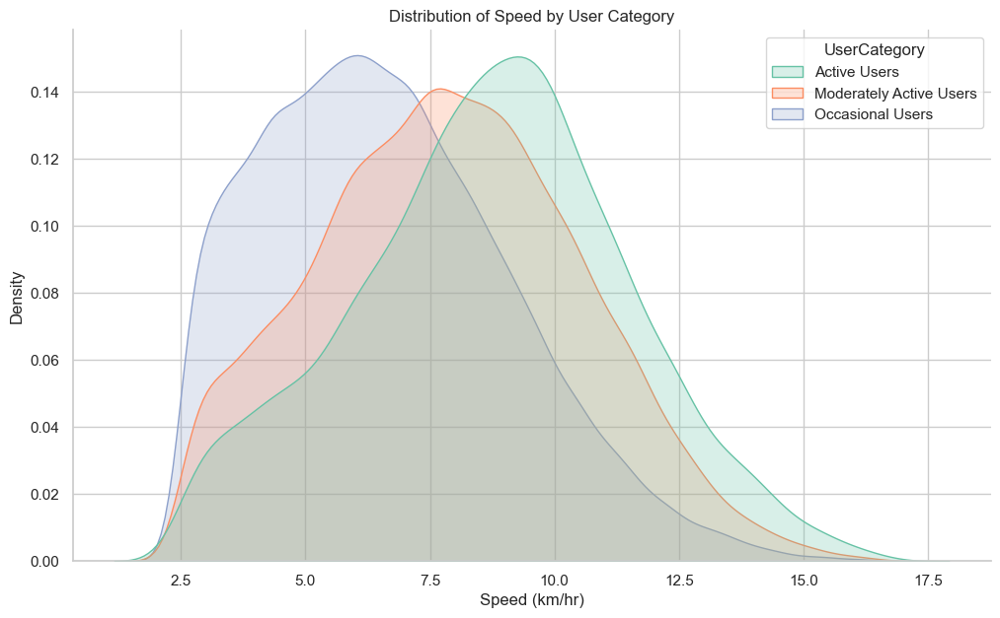

In [120]:
# plot the distribution of SpeedKmHr for each UserCategory to check for normality use a kde plot with seaborn
fig, ax = plt.subplots(figsize=(12, 7))
sns.kdeplot(data=trips, x='SpeedKmHrHav', hue='UserCategory', fill=True, palette='Set2', common_norm=False, ax=ax)
ax.set_title('Distribution of Speed by User Category')
ax.set_xlabel('Speed (km/hr)')
ax.set_ylabel('Density')
sns.despine()
plt.show()




In [122]:
# describe the SpeedKmHr for each UserCategory
trips.groupby('UserCategory')['SpeedKmHrHav'].describe()


,count,mean,std,min,25%,50%,75%,max
UserCategory,,,,,,,,
Active Users,8921.0,8.699750,2.751526,2.502408,6.868546,8.816600,10.533899,16.582255
Moderately Active Users,29820.0,7.858369,2.666678,2.500106,5.915736,7.824550,9.726080,16.558749
Occasional Users,43512.0,6.608805,2.487164,2.500215,4.660673,6.374967,8.246038,16.463527


In [123]:
# perform anova for difference between groups for HaversineDistance
pairwise_results_sp = pg.pairwise_tests(data=trips, dv='SpeedKmHrHav', between='UserCategory', padjust='bonf', alpha = 0.05, parametric=False, effsize="hedges").round(4)
pairwise_results_sp

,Contrast,A,B,Paired,Parametric,U-val,alternative,p-unc,p-corr,p-adjust,hedges
0,UserCategory,Active Users,Moderately Active Users,False,False,156785304.0,two-sided,0.0,0.0,bonf,0.3132
1,UserCategory,Active Users,Occasional Users,False,False,278358330.0,two-sided,0.0,0.0,bonf,0.8251
2,UserCategory,Moderately Active Users,Occasional Users,False,False,827078053.0,two-sided,0.0,0.0,bonf,0.4878


In [ ]:
distance_speed_melted

,UserCategory,Metric,Value
0,Active Users,HaversineDistance,2.695704
1,Moderately Active Users,HaversineDistance,2.582241
2,Occasional Users,HaversineDistance,2.571363
3,Active Users,SpeedKmHr,12.189715
4,Moderately Active Users,SpeedKmHr,11.878808
5,Occasional Users,SpeedKmHr,9.560233


#### speed and distance analysis
Active users complete longer trips at higher speeds, indicating a more experienced or committed user group. This insight can inform targeted marketing strategies or user engagement initiatives to retain and attract active users. Additionally, the analysis of speed and distance can provide valuable insights into user behavior and preferences, guiding the design of bike-sharing services and infrastructure to better meet user needs. Here are several analytical approaches and methodologies to leverage speed and distance data for user insights: 

### 1. User Segmentation
Segment users based on their average trip distance and speed to identify distinct user groups with different usage patterns:
- **Long-Distance vs. Short-Distance Users**: Compare the behavior and preferences of users who complete longer trips at higher speeds against those who prefer shorter trips at lower speeds. This segmentation can help tailor services to meet the needs of different user groups.
- **Speed-Based Segments**: Segment users based on their average speed to identify groups of fast riders and leisurely riders. This can inform infrastructure planning and service design to accommodate different riding styles.

### 2. Usage Pattern Analysis
Analyze the usage patterns of individual users or user segments over time to identify trends, such as:
- **Temporal Patterns**: Identify peak usage times for different user segments based on speed and distance. Are there differences in usage patterns during peak vs. off-peak hours?
- **Spatial Patterns**: Examine if certain users prefer longer or faster trips in specific areas or for specific trip purposes, such as commuting or leisure.

### 3. Comparative Analysis
Perform a comparative analysis of bike-sharing usage for different user groups to determine:
- **Mode Preference by User Segment**: Do users who complete longer or faster trips show a stronger preference for bike-sharing over other modes of transport? This could indicate a specific user group that values the speed and convenience of bike-sharing.
- **Impact of Distance on Usage**: For users with similar speed patterns, does the average trip distance correlate with higher or lower bike-sharing usage? This can inform infrastructure planning and station placement.

### 4. Behavior Over Time
Investigate how individual or segmented user behaviors change over time with respect to:
- **Changes in Trip Characteristics**: Do users tend to complete longer or faster trips over time, indicating a shift in preferences or behavior? This can inform service adjustments and user engagement strategies.
- **Seasonal or Weather-Related Patterns**: Analyze if and how user patterns change with seasons or weather conditions, particularly for those who use bike-sharing for commuting or recreational purposes.

### Methodological Considerations:
- **Data Quality and Granularity**: Verify the accuracy and granularity of the speed and distance data, especially for longitudinal analyses, to ensure meaningful insights.
- **Statistical Significance**: When comparing groups or trends, ensure statistical tests are used to determine the significance of observed patterns.
- **User Anonymity**: Ensure the analysis respects user privacy and data protection laws, anonymizing user IDs where necessary.

### Implementation Approach:
To implement these analyses, you could use a combination of data manipulation, statistical testing, and machine learning clustering techniques (e.g., k-means for segmentation) within a Python environment using libraries such as Pandas, NumPy, Scikit-learn, and Seaborn/Matplotlib for visualization.

By leveraging speed and distance data, you can gain valuable insights into user behavior and preferences related to bike-sharing, enabling more personalized and efficient transportation solutions.


In [ ]:
trips.columns

Index(['StartTime', 'EndTime', 'UserId', 'latitudeStart', 'longitudeStart',
       'nameStart', 'latitudeEnd', 'longitudeEnd', 'nameEnd',
       'StartHubClusterId', 'EndHubClusterId', 'StartClusterName',
       'EndClusterName', 'StartClusterLatitude', 'StartClusterLongitude',
       'EndClusterLatitude', 'EndClusterLongitude', 'HaversineDistance',
       'Month', 'StartHour', 'Weekday', 'TripDurationMin', 'TripDurationHr',
       'SpeedKmHr', 'RoundTrip', 'Route', 'YearMonth', 'DurationGroup',
       'StartTimeUpdated', 'TotalDurationMin', 'TripDistanceKm',
       'TotalWalkingTimeMin', 'TotalTransitTimeMin', 'Changes',
       'PickupStationProximity', 'DropoffStationProximity', 'SpeedKmHrHav',
       'SpeedKmHrP', 'DayType', 'UserCategory'],
      dtype='object')

In [ ]:
import pingouin as pg

# perform pairwise comparisons using pingouin.pairwise_tests on trips_melted for the 'DurationType' and 'Changes' columns
pairwise_results = pg.pairwise_tests(data=trips_melted, dv='Duration', between=['Changes','DurationType'], padjust='bonf')
pairwise_results['p-unc'] = pairwise_results['p-unc'].apply(lambda x: format(x, '.4f'))
pairwise_results['p-corr'] = pairwise_results['p-corr'].apply(lambda x: format(x, '.4f')) 
pairwise_results

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\bayesian.py:152: RuntimeWarning:

divide by zero encountered in scalar divide



,Contrast,Changes,A,B,Paired,Parametric,T,dof,alternative,p-unc,p-corr,p-adjust,BF10,hedges
0,Changes,-,0.0,1.0,False,True,-86.454694,23347.977934,two-sided,0.0000,0.0000,bonf,inf,-0.767499
1,Changes,-,0.0,2.0,False,True,-27.022040,826.984227,two-sided,0.0000,0.0000,bonf,2.058e+156,-1.444256
2,Changes,-,1.0,2.0,False,True,-12.142675,867.498837,two-sided,0.0000,0.0000,bonf,2.344e+30,-0.531084
3,DurationType,-,TotalDurationMin,TripDurationMin,False,True,-13.838270,164502.000000,two-sided,0.0000,nan,NaN,1.998e+39,-0.068237
4,Changes * DurationType,0.0,TotalDurationMin,TripDurationMin,False,True,-15.461763,144024.000000,two-sided,0.0000,0.0000,bonf,4.35e+49,-0.081483
5,Changes * DurationType,1.0,TotalDurationMin,TripDurationMin,False,True,-1.197422,19652.000000,two-sided,0.2312,0.6935,bonf,0.033,-0.017082
6,Changes * DurationType,2.0,TotalDurationMin,TripDurationMin,False,True,1.678668,822.000000,two-sided,0.0936,0.2808,bonf,0.31,0.116852
